## Importing Libraries

In [1]:
# Import libraries.
from __future__ import division
from datetime import datetime, timedelta, date
import pandas as pd
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

import chart_studio.plotly as py
import plotly.offline as pyoff
import plotly.graph_objs as go

from sklearn.metrics import classification_report,confusion_matrix
from sklearn.cluster import KMeans
import xgboost as xgb
from sklearn.model_selection import KFold, cross_val_score, train_test_split
from sklearn.preprocessing import LabelEncoder

In [2]:
# Initiate visualization library for jupyter notebook.
pyoff.init_notebook_mode()

## Pushing Data to AWS S3

In [3]:
# Import boto3 to access s3 bucket.
# Retrieve the list of existing buckets.
import logging
import boto3
from botocore.exceptions import ClientError
s3 = boto3.client('s3')
response = s3.list_buckets()

print('Existing buckets:')
for bucket in response['Buckets']:
    print(f' {bucket["Name"]}')

Existing buckets:
 big-data-homework-zg
 data-bootcamp-zg-001
 dataviz-zg
 telco-customers
 zappa-4505j60vv
 zappa-wxngbbi3m


In [4]:
# Function to upload a file.
def upload_file(file_name, bucket, object_name=None):
    """Upload a file to an S3 bucket
    
    :param file_name: File to upload
    :param bucket: Bucket to upload file to
    :param object_name: S3 object name. If not specified then file_name is used
    :return: True if file was uploaded, else False"""
    
    # If S3 object_name was not specified, use file_name.
    if object_name is None:
        object_name = file_name
        
    # Upload the file.
    s3_client = boto3.client('s3')
    try:
        response = s3_client.upload_file(file_name, bucket, object_name)
    except ClientError as e:
        logging.error(e)
        return False
    return True

In [5]:
# Define bucket to upload files to.
bucketName='telco-customers'

In [6]:
# # Upload Churn file to S3 bucket.
# fileName='data/Telco-Customer-Churn.csv'
# upload_file(fileName, bucketName)

## Part 4: Churn Prediction

Since we know our best customers by segmentation and lifetime value prediction, we should also work hard on retaining them. That’s what makes Retention Rate is one of the most critical metrics.

Retention Rate is an indication of how good is your product market fit (PMF). If your PMF is not satisfactory, you should see your customers churning very soon. One of the powerful tools to improve Retention Rate (hence the PMF) is Churn Prediction. By using this technique, you can easily find out who is likely to churn in the given period.

Steps to develop a churn prediction model:

* Exploratory data analysis

* Feature engineering

* Investigating how the features affect Retention by using Logistic Regression

* Building a classification model with XGBoost

### Exploratory Data Analysis:

In [7]:
# Download the OnlineRetail.csv file.
s3.download_file(bucketName, 'data/Telco-Customer-Churn.csv', 'data/Telco-Customer-Churn.csv')

In [8]:
# Read CSV into Pandas DF and display first 10 rows.
telco_df = pd.read_csv('data/Telco-Customer-Churn.csv', encoding = 'unicode_escape')
telco_df.head(10)

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,...,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,...,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,...,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes
5,9305-CDSKC,Female,0,No,No,8,Yes,Yes,Fiber optic,No,...,Yes,No,Yes,Yes,Month-to-month,Yes,Electronic check,99.65,820.5,Yes
6,1452-KIOVK,Male,0,No,Yes,22,Yes,Yes,Fiber optic,No,...,No,No,Yes,No,Month-to-month,Yes,Credit card (automatic),89.10,1949.4,No
7,6713-OKOMC,Female,0,No,No,10,No,No phone service,DSL,Yes,...,No,No,No,No,Month-to-month,No,Mailed check,29.75,301.9,No
8,7892-POOKP,Female,0,Yes,No,28,Yes,Yes,Fiber optic,No,...,Yes,Yes,Yes,Yes,Month-to-month,Yes,Electronic check,104.80,3046.05,Yes
9,6388-TABGU,Male,0,No,Yes,62,Yes,No,DSL,Yes,...,No,No,No,No,One year,No,Bank transfer (automatic),56.15,3487.95,No


In [9]:
telco_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 21 columns):
customerID          7043 non-null object
gender              7043 non-null object
SeniorCitizen       7043 non-null int64
Partner             7043 non-null object
Dependents          7043 non-null object
tenure              7043 non-null int64
PhoneService        7043 non-null object
MultipleLines       7043 non-null object
InternetService     7043 non-null object
OnlineSecurity      7043 non-null object
OnlineBackup        7043 non-null object
DeviceProtection    7043 non-null object
TechSupport         7043 non-null object
StreamingTV         7043 non-null object
StreamingMovies     7043 non-null object
Contract            7043 non-null object
PaperlessBilling    7043 non-null object
PaymentMethod       7043 non-null object
MonthlyCharges      7043 non-null float64
TotalCharges        7043 non-null object
Churn               7043 non-null object
dtypes: float64(1), int64(2), obj

The data falls under two categories:

* Categorical Features: gender, streaming tv, payment method, etc.

* Numerical Features: tenure, monthly charges, and total charges.

Before ananlysing each of our features to identify how helpful they might be in determining customer churn, lets first convert encode Yes/No as an integer (Yes=1, No=0).

In [10]:
# Convert Churn Yes/No to binary integers.
telco_df.loc[telco_df.Churn=='No', 'Churn'] = 0
telco_df.loc[telco_df.Churn=='Yes', 'Churn'] = 1

In [11]:
telco_df.Churn.value_counts()

0    5174
1    1869
Name: Churn, dtype: int64

In [12]:
# Actual Churn Rate.
(telco_df.query("Churn == 1")['Churn'].count() / telco_df.Churn.count()) * 100

26.536987079369588

### Categorical Features:

#### Gender

In [13]:
def group_df(field):
    grouped_DF = telco_df.groupby(field).Churn.mean().reset_index()
    return grouped_DF

In [14]:
group_df('gender')

,gender,Churn
0,Female,0.269209
1,Male,0.261603


In [15]:
gender_plot = telco_df.groupby('gender').Churn.mean().reset_index()
gender_plot

,gender,Churn
0,Female,0.269209
1,Male,0.261603


In [16]:
(float(gender_plot.query("gender=='Female'")['Churn']) -
 float(gender_plot.query("gender=='Male'")['Churn'])) * 100

0.7605340068904065

In [17]:
gender_plot.Churn

0    0.269209
1    0.261603
Name: Churn, dtype: float64

The difference between Customer Churn by gender is minimal, let's visualize.

In [18]:
plot_data_gender = [
    go.Bar(
        x=gender_plot['gender'],
        y=gender_plot['Churn'],
        width=[0.5, 0.5],
        text=gender_plot['Churn'],
        name="Gender",
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Gender</b>: %{x}<br>',
        marker= dict(color=['green', 'purple'])
    )
]

plot_layout_gender = go.Layout(
        xaxis={'type': "category"},
        yaxis={'title': "Churn Rate"},
        title='Churn Rate by Gender',
        plot_bgcolor  = 'rgb(243,243,243)',
        paper_bgcolor  = 'rgb(243,243,243)'
)

fig_gender = go.Figure(data=plot_data_gender, layout=plot_layout_gender)
pyoff.iplot(fig_gender)

#### Partner:

Whether the customer has a partner, or not.

In [19]:
partner_plot = telco_df.groupby('Partner').Churn.mean().reset_index()
partner_plot

,Partner,Churn
0,No,0.329580
1,Yes,0.196649


In [20]:
(float(partner_plot.query("Partner=='No'")['Churn']) -
 float(partner_plot.query("Partner=='Yes'")['Churn'])) * 100

13.293075579077593

There is 13% difference between customers without partners to those with partners that have churned.

In [21]:
plot_data_partner = [
    go.Bar(
        x=partner_plot['Partner'],
        y=partner_plot['Churn'],
        width=[0.5, 0.5],
        name='Partner',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Partner</b>: %{x}<br>',
        marker= dict(color=['green', 'purple'])
    )
]

plot_layout_partner = go.Layout(
        xaxis={'type': "category"},
        yaxis={'title': "Churn Rate"},
        title='Churn Rate by Partner',
        plot_bgcolor  = 'rgb(243,243,243)',
        paper_bgcolor  = 'rgb(243,243,243)'
)

fig_partner = go.Figure(data=plot_data_partner, layout=plot_layout_partner)
pyoff.iplot(fig_partner)

#### Phone Service:

Whether the customer has a phone service or not (Yes, No)

In [22]:
phoneService_plot = telco_df.groupby('PhoneService').Churn.mean().reset_index()
phoneService_plot

,PhoneService,Churn
0,No,0.249267
1,Yes,0.267096


In [23]:
(float(phoneService_plot.query("PhoneService=='Yes'")['Churn']) -
 float(phoneService_plot.query("PhoneService=='No'")['Churn'])) * 100

1.782950632543162

There is only a slight difference in churn between customers with or without phone service.

In [24]:
plot_data_phoneService = [
    go.Bar(
        x=phoneService_plot['PhoneService'],
        y=phoneService_plot['Churn'],
        width=[0.5, 0.5],
        name='Phone Service',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Phone Service</b>: %{x}<br>',
        marker= dict(color=['green', 'purple'])
    )
]

plot_layout_phoneService = go.Layout(
        xaxis={'type': "category"},
        yaxis={'title': "Churn Rate"},
        title='Churn Rate by Phone Service',
        plot_bgcolor  = 'rgb(243,243,243)',
        paper_bgcolor  = 'rgb(243,243,243)'
)

fig_phoneService = go.Figure(data=plot_data_phoneService, layout=plot_layout_phoneService)
pyoff.iplot(fig_phoneService)

#### Multiple Lines

Whether the customer has multiple lines or not (Yes, No, No phone service)

In [25]:
multipleLines_plot = telco_df.groupby('MultipleLines').Churn.mean().reset_index()
multipleLines_plot

,MultipleLines,Churn
0,No,0.250442
1,No phone service,0.249267
2,Yes,0.286099


In [26]:
plot_data_multipleLines = [
    go.Bar(
        x=multipleLines_plot['MultipleLines'],
        y=multipleLines_plot['Churn'],
        width=[0.5, 0.5, 0.5],
        name='Multiple Lines',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Multiple Lines</b>: %{x}<br>',
        marker= dict(color=['green', 'slategray', 'purple'])
    )
]

plot_layout_multipleLines = go.Layout(
        xaxis={'type': "category"},
        yaxis={'title': "Churn Rate"},
        title='Churn Rate by Multiple Lines',
        plot_bgcolor  = 'rgb(243,243,243)',
        paper_bgcolor  = 'rgb(243,243,243)'
)

fig_multipleLines = go.Figure(data=plot_data_multipleLines, layout=plot_layout_multipleLines)
pyoff.iplot(fig_multipleLines)

#### Internet Service

Customer’s internet service provider (DSL, Fiber optic, No)

In [27]:
internetService_plot = telco_df.groupby('InternetService').Churn.mean().reset_index()
internetService_plot

,InternetService,Churn
0,DSL,0.189591
1,Fiber optic,0.418928
2,No,0.074050


In [28]:
(float(internetService_plot.query("InternetService=='Fiber optic'")['Churn']) -
 float(internetService_plot.query("InternetService=='DSL'")['Churn'])) * 100

22.933657051189687

There is a substantial difference between Churn rates for customers that used Fiber Optic as opposed to DSL services.

This is quite surprising because we normally expect Fiber Optic customers to churn less due to the fact that they use a more premium service. But this can happen due to high prices, competition, customer service, and many other reasons.

In [29]:
plot_data_internetService = [
    go.Bar(
        x=internetService_plot['InternetService'],
        y=internetService_plot['Churn'],
        width=[0.5, 0.5, 0.5],
        name='Internet Service',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Internet Service</b>: %{x}<br>',
        marker= dict(color=['green', 'slategray', 'purple'])
    )
]

plot_layout_internetService = go.Layout(
        xaxis={'type': "category"},
        yaxis={'title': "Churn Rate"},
        title='Churn Rate by Internet Service',
        plot_bgcolor  = 'rgb(243,243,243)',
        paper_bgcolor  = 'rgb(243,243,243)'
)

fig_internetService = go.Figure(data=plot_data_internetService, layout=plot_layout_internetService)
pyoff.iplot(fig_internetService)

#### Online Security

Whether the customer has online security or not (Yes, No, No internet service)

In [30]:
onlineSecurity_plot = telco_df.groupby('OnlineSecurity').Churn.mean().reset_index()
onlineSecurity_plot

,OnlineSecurity,Churn
0,No,0.417667
1,No internet service,0.074050
2,Yes,0.146112


In [31]:
(float(onlineSecurity_plot.query("OnlineSecurity=='No'")['Churn']) -
 float(onlineSecurity_plot.query("OnlineSecurity=='Yes'")['Churn'])) * 100

27.155530181967702

There is a substantial difference between Churn rates for customers that do and don't have Online Security. Customers without are roughly 27% more likely to churn.

In [32]:
plot_data_onlineSecurity = [
    go.Bar(
        x=onlineSecurity_plot['OnlineSecurity'],
        y=onlineSecurity_plot['Churn'],
        width=[0.5, 0.5, 0.5],
        name='Online Security',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Online Security</b>: %{x}<br>',
        marker= dict(color=['green', 'slategray', 'purple'])
    )
]

plot_layout_onlineSecurity = go.Layout(
        xaxis={'type': "category"},
        yaxis={'title': "Churn Rate"},
        title='Churn Rate by Online Security',
        plot_bgcolor  = 'rgb(243,243,243)',
        paper_bgcolor  = 'rgb(243,243,243)'
)

fig_onlineSecurity = go.Figure(data=plot_data_onlineSecurity, layout=plot_layout_onlineSecurity)
pyoff.iplot(fig_onlineSecurity)

#### Online Backup

Whether the customer has online backup or not (Yes, No, No internet service)

In [33]:
onlineBackup_plot = telco_df.groupby('OnlineBackup').Churn.mean().reset_index()
onlineBackup_plot

,OnlineBackup,Churn
0,No,0.399288
1,No internet service,0.074050
2,Yes,0.215315


In [34]:
(float(onlineBackup_plot.query("OnlineBackup=='No'")['Churn']) -
 float(onlineBackup_plot.query("OnlineBackup=='Yes'")['Churn'])) * 100

18.39726203452667

There is a  difference between Churn rates for customers that do and don't have Online Backup. Customers without are roughly 18% more likely to churn.

In [35]:
plot_data_onlineBackup = [
    go.Bar(
        x=onlineBackup_plot['OnlineBackup'],
        y=onlineBackup_plot['Churn'],
        width=[0.5, 0.5, 0.5],
        name='Online Backup',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Online Backup</b>: %{x}<br>',
        marker= dict(color=['green', 'slategray', 'purple'])
    )
]

plot_layout_onlineBackup = go.Layout(
        xaxis={'type': "category"},
        yaxis={'title': "Churn Rate"},
        title='Churn Rate by Online Backup',
        plot_bgcolor  = 'rgb(243,243,243)',
        paper_bgcolor  = 'rgb(243,243,243)'
)

fig_onlineBackup = go.Figure(data=plot_data_onlineBackup, layout=plot_layout_onlineBackup)
pyoff.iplot(fig_onlineBackup)

#### Device Protection

Whether the customer has device protection or not (Yes, No, No internet service)

In [36]:
deviceProtection_plot = telco_df.groupby('DeviceProtection').Churn.mean().reset_index()
deviceProtection_plot

,DeviceProtection,Churn
0,No,0.391276
1,No internet service,0.074050
2,Yes,0.225021


In [37]:
(float(deviceProtection_plot.query("DeviceProtection=='No'")['Churn']) -
 float(deviceProtection_plot.query("DeviceProtection=='Yes'")['Churn'])) * 100

16.62556079235975

In [38]:
plot_data_deviceProtection = [
    go.Bar(
        x=deviceProtection_plot['DeviceProtection'],
        y=deviceProtection_plot['Churn'],
        width=[0.5, 0.5, 0.5],
        name='Device Protection',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Device Protection</b>: %{x}<br>',
        marker= dict(color=['green', 'slategray', 'purple'])
    )
]

plot_layout_deviceProtection = go.Layout(
        xaxis={'type': "category"},
        yaxis={'title': "Churn Rate"},
        title='Churn Rate by Device Protection',
        plot_bgcolor  = 'rgb(243,243,243)',
        paper_bgcolor  = 'rgb(243,243,243)'
)

fig_deviceProtection = go.Figure(data=plot_data_deviceProtection, layout=plot_layout_deviceProtection)
pyoff.iplot(fig_deviceProtection)

#### Tech Support

Whether the customer has tech support or not (Yes, No, No internet service)

In [39]:
techSupport_plot = telco_df.groupby('TechSupport').Churn.mean().reset_index()
techSupport_plot

,TechSupport,Churn
0,No,0.416355
1,No internet service,0.074050
2,Yes,0.151663


In [40]:
(float(techSupport_plot.query("TechSupport=='No'")['Churn']) -
 float(techSupport_plot.query("TechSupport=='Yes'")['Churn'])) * 100

26.46913314509527

Customers that don't use tech support are roughly 26% more likely to churn.

In [41]:
plot_data_techSupport = [
    go.Bar(
        x=techSupport_plot['TechSupport'],
        y=techSupport_plot['Churn'],
        width=[0.5, 0.5, 0.5],
        name='Tech Support',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Tech Support</b>: %{x}<br>',
        marker= dict(color=['green', 'slategray', 'purple'])
    )
]

plot_layout_techSupport = go.Layout(
        xaxis={'type': "category"},
        yaxis={'title': "Churn Rate"},
        title='Churn Rate by Tech Support',
        plot_bgcolor  = 'rgb(243,243,243)',
        paper_bgcolor  = 'rgb(243,243,243)'
)

fig_techSupport = go.Figure(data=plot_data_techSupport, layout=plot_layout_techSupport)
pyoff.iplot(fig_techSupport)

#### StreamingTV

Whether the customer has streaming TV or not (Yes, No, No internet service)

In [42]:
streamingTV_plot = telco_df.groupby('StreamingTV').Churn.mean().reset_index()
streamingTV_plot

,StreamingTV,Churn
0,No,0.335231
1,No internet service,0.074050
2,Yes,0.300702


In [43]:
(float(streamingTV_plot.query("StreamingTV=='No'")['Churn']) -
 float(streamingTV_plot.query("StreamingTV=='Yes'")['Churn'])) * 100

3.452943272154574

Although not substational, customers that don't stream TV are roughly 3% more likely to churn.

In [44]:
plot_data_streamingTV = [
    go.Bar(
        x=streamingTV_plot['StreamingTV'],
        y=streamingTV_plot['Churn'],
        width=[0.5, 0.5, 0.5],
        name='Streaming TV',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Streaming TV</b>: %{x}<br>',
        marker= dict(color=['green', 'slategray', 'purple'])
    )
]

plot_layout_streamingTV = go.Layout(
        xaxis={'type': "category"},
        yaxis={'title': "Churn Rate"},
        title='Churn Rate by Streaming TV',
        plot_bgcolor  = 'rgb(243,243,243)',
        paper_bgcolor  = 'rgb(243,243,243)'
)

fig_streamingTV = go.Figure(data=plot_data_streamingTV, layout=plot_layout_streamingTV)
pyoff.iplot(fig_streamingTV)

#### StreamingMovies 

Whether the customer has streaming movies or not (Yes, No, No internet service)

In [45]:
streamingMovies_plot = telco_df.groupby('StreamingMovies').Churn.mean().reset_index()
streamingMovies_plot

,StreamingMovies,Churn
0,No,0.336804
1,No internet service,0.074050
2,Yes,0.299414


In [46]:
(float(streamingMovies_plot.query("StreamingMovies=='No'")['Churn']) -
 float(streamingMovies_plot.query("StreamingMovies=='Yes'")['Churn'])) * 100

3.7389960334462735

In [47]:
plot_data_streamingMovies = [
    go.Bar(
        x=streamingMovies_plot['StreamingMovies'],
        y=streamingMovies_plot['Churn'],
        width=[0.5, 0.5, 0.5],
        name='Streaming Movies',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Streaming Movies</b>: %{x}<br>',
        marker= dict(color=['green', 'slategray', 'purple'])
    )
]

plot_layout_streamingMovies = go.Layout(
        xaxis={'type': "category"},
        yaxis={'title': "Churn Rate"},
        title='Churn Rate by Streaming Movies',
        plot_bgcolor  = 'rgb(243,243,243)',
        paper_bgcolor  = 'rgb(243,243,243)'
)

fig_streamingMovies = go.Figure(data=plot_data_streamingMovies, layout=plot_layout_streamingMovies)
pyoff.iplot(fig_streamingMovies)

#### Contract

The contract term of the customer (Month-to-month, One year, Two year)

In [48]:
contract_plot = telco_df.groupby('Contract').Churn.mean().reset_index()
contract_plot

,Contract,Churn
0,Month-to-month,0.427097
1,One year,0.112695
2,Two year,0.028319


In [49]:
monthly_year1 = (float(contract_plot.query("Contract=='Month-to-month'")['Churn']) -
 float(contract_plot.query("Contract=='One year'")['Churn'])) * 100

monthly_year2 = (float(contract_plot.query("Contract=='Month-to-month'")['Churn']) -
 float(contract_plot.query("Contract=='Two year'")['Churn'])) * 100

year1_year2 = (float(contract_plot.query("Contract=='One year'")['Churn']) -
 float(contract_plot.query("Contract=='Two year'")['Churn'])) * 100

print(f'Churn Rate Difference Between Monthly & 1 Year = {round(monthly_year1, 2)}%\nChurn Rate Difference Between Monthly & 2 Year = {round(monthly_year2, 2)}%\nChurn Rate Difference Between 1 Year & 2 Year = {round(year1_year2, 2)}%')

Churn Rate Difference Between Monthly & 1 Year = 31.44%
Churn Rate Difference Between Monthly & 2 Year = 39.88%
Churn Rate Difference Between 1 Year & 2 Year = 8.44%


Customers with a monthly contract are substantially more likely to churn than those 1 year or 2 year contracts.

In [50]:
plot_data_contract = [
    go.Bar(
        x=contract_plot['Contract'],
        y=contract_plot['Churn'],
        width=[0.5, 0.5, 0.5],
        name='Contract',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Contract</b>: %{x}<br>',
        marker= dict(color=['green', 'slategray', 'purple'])
    )
]

plot_layout_contract = go.Layout(
        xaxis={'type': "category"},
        yaxis={'title': "Churn Rate"},
        title='Churn Rate by Contract Type',
        plot_bgcolor  = 'rgb(243,243,243)',
        paper_bgcolor  = 'rgb(243,243,243)'
)

fig_contract = go.Figure(data=plot_data_contract, layout=plot_layout_contract)
pyoff.iplot(fig_contract)

#### PaperlessBilling

Whether the customer has paperless billing or not (Yes, No)

In [51]:
paperlessBilling_plot = telco_df.groupby('PaperlessBilling').Churn.mean().reset_index()
paperlessBilling_plot

,PaperlessBilling,Churn
0,No,0.163301
1,Yes,0.335651


In [52]:
paperlessBilling = (float(paperlessBilling_plot.query("PaperlessBilling=='Yes'")['Churn']) -
 float(paperlessBilling_plot.query("PaperlessBilling=='No'")['Churn'])) * 100
print(f'Churn Rate Difference Between Paperless Billing = {round(paperlessBilling, 2)}%')

Churn Rate Difference Between Paperless Billing = 17.24%


Customers with Paperless Billing are roughly 17% more likely to churn than those without.

In [53]:
plot_data_paperlessBilling = [
    go.Bar(
        x=paperlessBilling_plot['PaperlessBilling'],
        y=paperlessBilling_plot['Churn'],
        width=[0.5, 0.5],
        name='Paperless Billing',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Paperless Billing</b>: %{x}<br>',
        marker= dict(color=['green', 'purple'])
    )
]

plot_layout_paperlessBilling = go.Layout(
        xaxis={'type': "category"},
        yaxis={'title': "Churn Rate"},
        title='Churn Rate by Paperless Billing',
        plot_bgcolor  = 'rgb(243,243,243)',
        paper_bgcolor  = 'rgb(243,243,243)'
)

fig_paperlessBilling = go.Figure(data=plot_data_paperlessBilling, layout=plot_layout_paperlessBilling)
pyoff.iplot(fig_paperlessBilling)

#### Payment Method

The customer’s payment method (Electronic check, Mailed check, Bank transfer (automatic), Credit card (automatic))

In [54]:
paymentMethod_plot = telco_df.groupby('PaymentMethod').Churn.mean().reset_index()
paymentMethod_plot

,PaymentMethod,Churn
0,Bank transfer (automatic),0.167098
1,Credit card (automatic),0.152431
2,Electronic check,0.452854
3,Mailed check,0.191067


In [55]:
# count = final_telco_df.groupby('PaymentMethod').Churn.count().reset_index()
# count.info()

In [56]:
# final_telco_df.PaymentMethod.value_counts().reset_index()

In [57]:
eCheck_Bank = (float(paymentMethod_plot.query("PaymentMethod=='Electronic check'")['Churn']) -
 float(paymentMethod_plot.query("PaymentMethod=='Bank transfer (automatic)'")['Churn'])) * 100

eCheck_CC = (float(paymentMethod_plot.query("PaymentMethod=='Electronic check'")['Churn']) -
 float(paymentMethod_plot.query("PaymentMethod=='Credit card (automatic)'")['Churn'])) * 100

print(f'Churn Rate Difference Between Electronic Check & Bank Transfer (automatic) = {round(eCheck_Bank, 2)}%\nChurn Rate Difference Between Electronic Check & Credit Card (automatic) = {round(eCheck_CC, 2)}%')

Churn Rate Difference Between Electronic Check & Bank Transfer (automatic) = 28.58%
Churn Rate Difference Between Electronic Check & Credit Card (automatic) = 30.04%


Automating the payment makes the customer more likely to retain in your platform by roughly 30%.

In [58]:
plot_data_paymentMethod = [
    go.Bar(
        x=paymentMethod_plot['PaymentMethod'],
        y=paymentMethod_plot['Churn'],
        width=[0.5, 0.5, 0.5, 0.5],
        name='Payment Method',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Payment Method</b>: %{x}<br>',
        marker= dict(color=['green', 'slategray', 'purple', 'navy'])
    )
]

plot_layout_paymentMethod = go.Layout(
        xaxis={'type': "category"},
        yaxis={'title': "Churn Rate"},
        title='Churn Rate by Payment Method',
        plot_bgcolor  = 'rgb(243,243,243)',
        paper_bgcolor  = 'rgb(243,243,243)'
)

fig_paymentMethod = go.Figure(data=plot_data_paymentMethod, layout=plot_layout_paymentMethod)
pyoff.iplot(fig_paymentMethod)

### Numerical Features:

#### Tenure:

Number of months the customer has stayed with the company.

In [59]:
telco_df.tenure.describe()

count    7043.000000
mean       32.371149
std        24.559481
min         0.000000
25%         9.000000
50%        29.000000
75%        55.000000
max        72.000000
Name: tenure, dtype: float64

In [60]:
tenure_plot = telco_df.groupby('tenure').Churn.mean().reset_index()
# Drop 0 value.
tenure_plot.loc[~(tenure_plot==0).all(axis=1)]
tenure_plot

,tenure,Churn
0,0,0.000000
1,1,0.619902
2,2,0.516807
3,3,0.470000
4,4,0.471591
5,5,0.481203
6,6,0.363636
7,7,0.389313
8,8,0.341463
9,9,0.386555


It appears that Churn rate decreases as tenure increases, let's visualize as Scatterplot.

In [61]:
plot_data_tenure = [
    go.Scatter(
        x=tenure_plot['tenure'],
        y=tenure_plot['Churn'],
        mode='markers',
        name='Tenure',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Tenure</b>: %{x}<br>',
        marker= dict(size=7,
            line= dict(width=1),
            color= 'green',
            opacity= 0.8
            )
    )
]

plot_layout_tenure = go.Layout(
        yaxis= {'title': "Churn Rate"},
        xaxis= {'title': 'Tenure'},
        title='Tenure Based Churn Rate',
        hovermode ='closest',
        plot_bgcolor  = "rgb(243,243,243)",
        paper_bgcolor  = "rgb(243,243,243)"
    )

fig_tenure = go.Figure(data=plot_data_tenure, layout=plot_layout_tenure)
pyoff.iplot(fig_tenure)

#### Monthly Charges:

The amount charged to the customer monthly.

In [62]:
telco_df.MonthlyCharges.describe()

count    7043.000000
mean       64.761692
std        30.090047
min        18.250000
25%        35.500000
50%        70.350000
75%        89.850000
max       118.750000
Name: MonthlyCharges, dtype: float64

In [63]:
monthlyCharges_plot = telco_df.copy()
monthlyCharges_plot['MonthlyCharges'] = monthlyCharges_plot['MonthlyCharges'].astype(int)
monthlyCharges_plot = monthlyCharges_plot.groupby('MonthlyCharges').Churn.mean().reset_index()
monthlyCharges_plot

,MonthlyCharges,Churn
0,18,0.076923
1,19,0.090290
2,20,0.084249
3,21,0.080000
4,22,0.000000
5,23,0.120000
6,24,0.117318
7,25,0.112299
8,26,0.000000
9,28,0.666667


It's difficult to see any relationships from the DF table, let's visualize.

In [64]:
plot_data_monthlyCharges = [
    go.Scatter(
        x=monthlyCharges_plot['MonthlyCharges'],
        y=monthlyCharges_plot['Churn'],
        mode='markers',
        name='Monthly Charges',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Monthly Charges</b>: $%{x}<br>',
        marker= dict(size=7,
            line= dict(width=1),
            color= 'green',
            opacity= 0.8
            )
    )
]

plot_layout_monthlyCharges = go.Layout(
        yaxis= {'title': "Churn Rate"},
        xaxis= {'title': 'Monthly Charges'},
        title='Monthly Charges Based Churn Rate',
        hovermode ='closest',
        plot_bgcolor  = "rgb(243,243,243)",
        paper_bgcolor  = "rgb(243,243,243)"
    )

fig_monthlyCharges = go.Figure(data=plot_data_monthlyCharges, layout=plot_layout_monthlyCharges)
pyoff.iplot(fig_monthlyCharges)

#### Total Charges:

The total amount charged to the customer.

In [65]:
# Check telco_df to see if there are any missing, or Nan values.

telco_df[pd.to_numeric(telco_df['TotalCharges'], errors='coerce').isnull()]
# There does appear to be a few.

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
488,4472-LVYGI,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,...,Yes,Yes,Yes,No,Two year,Yes,Bank transfer (automatic),52.55,,0
753,3115-CZMZD,Male,0,No,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20.25,,0
936,5709-LVOEQ,Female,0,Yes,Yes,0,Yes,No,DSL,Yes,...,Yes,No,Yes,Yes,Two year,No,Mailed check,80.85,,0
1082,4367-NUYAO,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,25.75,,0
1340,1371-DWPAZ,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,...,Yes,Yes,Yes,No,Two year,No,Credit card (automatic),56.05,,0
3331,7644-OMVMY,Male,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,19.85,,0
3826,3213-VVOLG,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,25.35,,0
4380,2520-SGTTA,Female,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20.00,,0
5218,2923-ARZLG,Male,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,One year,Yes,Mailed check,19.70,,0
6670,4075-WKNIU,Female,0,Yes,Yes,0,Yes,Yes,DSL,No,...,Yes,Yes,Yes,No,Two year,No,Mailed check,73.35,,0


In [66]:
print(f'There are {len(telco_df[pd.to_numeric(telco_df["TotalCharges"], errors="coerce").isnull()])} missing values.')

There are 11 missing values.


In [67]:
# Convert missing values to Nan, then dropna.
telco_df.loc[pd.to_numeric(telco_df['TotalCharges'], errors='coerce').isnull(), 'TotalCharges'] = np.nan
telco_df = telco_df.dropna()

In [68]:
telco_df['TotalCharges'] = pd.to_numeric(telco_df['TotalCharges'], errors='coerce')

In [69]:
totalCharges_plot = telco_df.copy()
totalCharges_plot['TotalCharges'] = totalCharges_plot['TotalCharges'].astype(int)
totalCharges_plot = totalCharges_plot.groupby('TotalCharges').Churn.mean().reset_index()

In [70]:
plot_data_totalCharges = [
    go.Scatter(
        x=totalCharges_plot['TotalCharges'],
        y=totalCharges_plot['Churn'],
        mode='markers',
        name='Total Charges',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Total Charges</b>: $%{x}<br>',
        marker= dict(size= 7,
            line= dict(width=1),
            color= 'green',
            opacity= 0.8
           ),
    )
]

plot_layout_totalCharges = go.Layout(
        yaxis= {'title': "Churn Rate"},
        xaxis= {'title': "Total Charges"},
        title='Total Charge vs Churn rate',
        hovermode ='closest',
        plot_bgcolor  = "rgb(243,243,243)",
        paper_bgcolor  = "rgb(243,243,243)",
    )
fig_totalCharges = go.Figure(data=plot_data_totalCharges, layout=plot_layout_totalCharges)
pyoff.iplot(fig_totalCharges)

Unfortunately, there is no clear trend between Churn Rate and Monthly/Total Charges.

### Feature Engineering:

In this section, we are going to transform our raw features to extract more information from them. Our strategy is as follows:

1. Group the numerical columns by using clustering techniques

2. Apply Label Encoder to categorical features which are binary

3. Apply get_dummies() to categorical features which have multiple values

##### Numerical Columns

As we know from the EDA section, We have three numerical columns:

* Tenure

* Monthly Charges

* Total Charges

We are going to apply the following steps to create groups:

1. Using Elbow Method to identify the appropriate number of clusters.

2. Applying K-means logic to the selected column and change the naming.

3. Observe the profile of clusters.

Let’s check how this works for Tenure in practice:

##### Cluster profiles:

In [71]:
# Function for ordering cluster numbers.
def order_cluster(cluster_field_name, target_field_name,df,ascending):
    new_cluster_field_name = 'new_' + cluster_field_name
    df_new = df.groupby(cluster_field_name)[target_field_name].mean().reset_index()
    df_new = df_new.sort_values(by=target_field_name,ascending=ascending).reset_index(drop=True)
    df_new['index'] = df_new.index
    df_final = pd.merge(df,df_new[[cluster_field_name,'index']], on=cluster_field_name)
    df_final = df_final.drop([cluster_field_name],axis=1)
    df_final = df_final.rename(columns={"index":cluster_field_name})
    return df_final

#### Tenure Cluster:

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#i

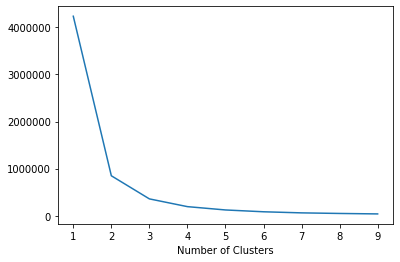

In [72]:
# We should tell how many clusters we need to K-means algorithm.
# To find it out, we will apply Elbow Method.
# Elbow Method simply tells the optimal cluster number for optimal inertia.

# Empty dictionary for SSE: sum of the squared differences between each observation and its group's mean.
sse={}
df_cluster = telco_df[['tenure']]
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(df_cluster)
    df_cluster['clusters'] = kmeans.labels_
    sse[k] = kmeans.inertia_
    
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of Clusters")
plt.show()

In [73]:
# Apply KMeans to predict Tenure Clusters.
kmeans = KMeans(n_clusters=3)
kmeans.fit(telco_df[['tenure']])
telco_df['TenureCluster'] = kmeans.predict(telco_df[['tenure']])

In [74]:
# Apply order_cluster function to Tenure Cluster.
telco_df = order_cluster('TenureCluster', 'tenure', telco_df, True)

In [75]:
telco_df.groupby('TenureCluster').tenure.describe()

,count,mean,std,min,25%,50%,75%,max
TenureCluster,,,,,,,,
0,2867.0,7.541332,5.970615,1.0,2.0,6.0,12.0,20.0
1,1926.0,33.854102,8.208706,21.0,26.0,34.0,41.0,48.0
2,2239.0,63.048682,7.478229,49.0,56.0,64.0,70.0,72.0


In [76]:
# Apply Low, Mid, High labels to each Tenure Cluster.
telco_df['TenureCluster'] = telco_df['TenureCluster'].replace({0:'Low', 1:'Mid', 2:'High'})

In [77]:
# Group by each Tenure Cluster and calculate the average churn rate for each.
tenureCluster_plot = telco_df.groupby('TenureCluster').Churn.mean().reset_index()
tenureCluster_plot

,TenureCluster,Churn
0,High,0.095132
1,Low,0.436345
2,Mid,0.210280


In [78]:
tenureCluster_plot.to_csv("data/tenureCluster_plot.csv", index=False)
fileName='data/tenureCluster_plot.csv'
upload_file(fileName, bucketName)

True

In [79]:
# Plot Churn Rate for each Tenure Cluster.
plot_data_tenureCluster = [
    go.Bar(
        x=tenureCluster_plot['TenureCluster'],
        y=tenureCluster_plot['Churn'],
        width=[0.5, 0.5, 0.5],
        name='Tenure Cluster',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Tenure Cluster</b>: %{x}<br>',
        marker= dict(
            color=['green', 'slategray', 'purple']
        )
    )
]

plot_layout_tenureCluster = go.Layout(
        xaxis={"type": "category", "categoryarray": ['Low', 'Mid', 'High']},
        title='Tenure Cluster vs. Churn Rate',
        plot_bgcolor  = "rgb(243,243,243)",
        paper_bgcolor  = "rgb(243,243,243)"
)

fig_tenureCluster = go.Figure(data=plot_data_tenureCluster, layout=plot_layout_tenureCluster)
pyoff.iplot(fig_tenureCluster)

#### Monthly Charges Cluster:

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#inde

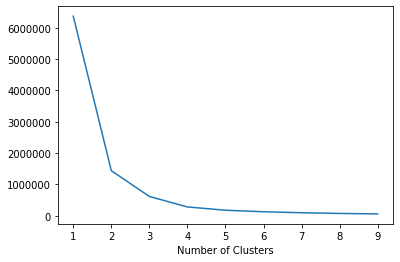

In [80]:
# Apply Elbow Method for Monthly Charges to determine optimal cluster number.
sse={}
df_cluster = telco_df[['MonthlyCharges']]
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(df_cluster)
    df_cluster["clusters"] = kmeans.labels_
    sse[k] = kmeans.inertia_ 
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of Clusters")
plt.show()

In [81]:
# Apply KMeans to predict Monthly Charges Clusters.
kmeans = KMeans(n_clusters=3)
kmeans.fit(telco_df[['MonthlyCharges']])
telco_df['MonthlyChargesCluster'] = kmeans.predict(telco_df[['MonthlyCharges']])

In [82]:
# Apply order_cluster function to Monthly Charges Cluster.
telco_df = order_cluster('MonthlyChargesCluster', 'MonthlyCharges', telco_df, True)

In [83]:
telco_df.groupby('MonthlyChargesCluster').MonthlyCharges.describe()

,count,mean,std,min,25%,50%,75%,max
MonthlyChargesCluster,,,,,,,,
0,1886.0,23.389608,5.666778,18.25,19.800,20.40,25.050,42.40
1,2235.0,61.630000,10.445398,42.60,51.775,61.55,70.700,77.80
2,2911.0,94.058794,10.342824,77.85,85.075,93.90,101.925,118.75


In [84]:
# Apply Low, Mid, High labels to each Monthly Charges Cluster.
telco_df['MonthlyChargesCluster'] = telco_df['MonthlyChargesCluster'].replace({0: 'Low', 1: 'Mid', 2: 'High'})

In [85]:
# Group by each Monthly Charges Cluster and calculate the average churn rate for each.
monthlyChargesCluster_plot = telco_df.groupby('MonthlyChargesCluster').Churn.mean().reset_index()
monthlyChargesCluster_plot

,MonthlyChargesCluster,Churn
0,High,0.345586
1,Low,0.121421
2,Mid,0.283669


In [86]:
monthlyChargesCluster_plot.to_csv("data/monthlyChargesCluster_plot.csv", index=False)
fileName='data/monthlyChargesCluster_plot.csv'
upload_file(fileName, bucketName)

True

In [87]:
# Plot Churn Rate for each Monthly Charges Cluster.
plot_data_monthlyChargesCluster = [
    go.Bar(
        x=monthlyChargesCluster_plot['MonthlyChargesCluster'],
        y=monthlyChargesCluster_plot['Churn'],
        width=[0.5, 0.5, 0.5],
        name='Monthly Charges Cluster',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Monthly Charges Cluster</b>: %{x}<br>',
        marker= dict(
            color=['green', 'slategray', 'purple']
        )
    )
]

plot_layout_monthlyChargesCluster = go.Layout(
        xaxis={"type": "category", "categoryarray": ['Low', 'Mid', 'High']},
        title='Monthly Charges Cluster vs. Churn Rate',
        plot_bgcolor  = "rgb(243,243,243)",
        paper_bgcolor  = "rgb(243,243,243)"
)

fig_monthlyChargesCluster = go.Figure(data=plot_data_monthlyChargesCluster, layout=plot_layout_monthlyChargesCluster)
pyoff.iplot(fig_monthlyChargesCluster)

#### Total Charges Cluster:

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#inde

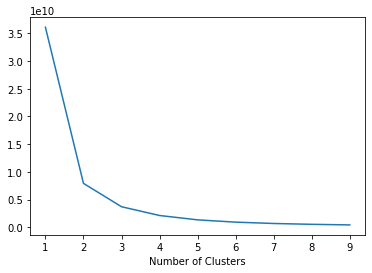

In [88]:
# Apply Elbow Method for Total Charges to determine optimal cluster number.
sse={}
df_cluster = telco_df[['TotalCharges']]
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(df_cluster)
    df_cluster["clusters"] = kmeans.labels_
    sse[k] = kmeans.inertia_ 
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of Clusters")
plt.show()

In [89]:
# Apply KMeans to predict Total Charges Clusters.
kmeans = KMeans(n_clusters=3)
kmeans.fit(telco_df[['TotalCharges']])
telco_df['TotalChargesCluster'] = kmeans.predict(telco_df[['TotalCharges']])

In [90]:
# Apply order_cluster function to Total Charges Cluster.
telco_df = order_cluster('TotalChargesCluster', 'TotalCharges', telco_df, True)

In [91]:
telco_df.groupby('TotalChargesCluster').TotalCharges.describe()

,count,mean,std,min,25%,50%,75%,max
TotalChargesCluster,,,,,,,,
0,4160.0,686.204087,572.025502,18.80,161.4875,535.95,1139.4125,1975.85
1,1613.0,3272.602139,814.144302,1978.65,2548.6500,3211.20,3970.4000,4779.45
2,1259.0,6292.972558,1003.372938,4783.50,5468.7000,6145.85,7040.1500,8684.80


In [92]:
# Apply Low, Mid, High labels to each Total Charges Cluster.
telco_df['TotalChargesCluster'] = telco_df['TotalChargesCluster'].replace({0: 'Low', 1: 'Mid', 2: 'High'})

In [93]:
# Group by each Total Charges Cluster and calculate the average churn rate for each.
totalChargesCluster_plot = telco_df.groupby('TotalChargesCluster').Churn.mean().reset_index()
totalChargesCluster_plot

,TotalChargesCluster,Churn
0,High,0.138205
1,Low,0.321394
2,Mid,0.221947


In [94]:
totalChargesCluster_plot.to_csv("data/totalChargesCluster_plot.csv", index=False)
fileName='data/totalChargesCluster_plot.csv'
upload_file(fileName, bucketName)

True

In [95]:
# Plot Churn Rate for each Total Charges Cluster.
plot_data_totalChargesCluster = [
    go.Bar(
        x=totalChargesCluster_plot['TotalChargesCluster'],
        y=totalChargesCluster_plot['Churn'],
        width=[0.5, 0.5, 0.5],
        name='Total Charges Cluster',
        hovertemplate =
    '<b>Churn Rate</b>: %{y:.2%}'+
    '<br><b>Total Charges Cluster</b>: %{x}<br>',
        marker= dict(
            color=['green', 'slategray', 'purple']
        )
    )
]

plot_layout_totalChargesCluster = go.Layout(
        xaxis={"type": "category", "categoryarray": ['Low', 'Mid', 'High']},
        title='Total Charges Cluster vs. Churn Rate',
        plot_bgcolor  = "rgb(243,243,243)",
        paper_bgcolor  = "rgb(243,243,243)"
)

fig_totalChargesCluster = go.Figure(data=plot_data_totalChargesCluster, layout=plot_layout_totalChargesCluster)
pyoff.iplot(fig_totalChargesCluster)

### Copy Dataframe for Final Table in Dashboard

In [96]:
final_telco_df = telco_df.copy()

#### Categorical Features:

In [97]:
telco_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7032 entries, 0 to 7031
Data columns (total 24 columns):
customerID               7032 non-null object
gender                   7032 non-null object
SeniorCitizen            7032 non-null int64
Partner                  7032 non-null object
Dependents               7032 non-null object
tenure                   7032 non-null int64
PhoneService             7032 non-null object
MultipleLines            7032 non-null object
InternetService          7032 non-null object
OnlineSecurity           7032 non-null object
OnlineBackup             7032 non-null object
DeviceProtection         7032 non-null object
TechSupport              7032 non-null object
StreamingTV              7032 non-null object
StreamingMovies          7032 non-null object
Contract                 7032 non-null object
PaperlessBilling         7032 non-null object
PaymentMethod            7032 non-null object
MonthlyCharges           7032 non-null float64
TotalCharges        

In [98]:
# Use label encoder to convert categorical coumns to numerical.
le = LabelEncoder()

# Array for multiple value columns.
dummy_columns = []

for column in telco_df.columns:
    if telco_df[column].dtype == object and column != 'customerID':
        if telco_df[column].nunique()  == 2:
            # Apply label encoder for binary Object columns.
            telco_df[column] = le.fit_transform(telco_df[column])
        else:
            dummy_columns.append(column)
            


In [99]:
print(dummy_columns)

['MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaymentMethod', 'TenureCluster', 'MonthlyChargesCluster', 'TotalChargesCluster']


In [100]:
telco_df.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,TenureCluster,MonthlyChargesCluster,TotalChargesCluster
0,7590-VHVEG,0,0,1,0,1,0,No phone service,DSL,No,...,No,Month-to-month,1,Electronic check,29.85,29.85,0,Low,Low,Low
1,6713-OKOMC,0,0,0,0,10,0,No phone service,DSL,Yes,...,No,Month-to-month,0,Mailed check,29.75,301.90,0,Low,Low,Low
2,7469-LKBCI,1,0,0,0,16,1,No,No,No internet service,...,No internet service,Two year,0,Credit card (automatic),18.95,326.80,0,Low,Low,Low
3,8779-QRDMV,1,1,0,0,1,0,No phone service,DSL,No,...,Yes,Month-to-month,1,Electronic check,39.65,39.65,1,Low,Low,Low
4,1680-VDCWW,1,0,1,0,12,1,No,No,No internet service,...,No internet service,One year,0,Bank transfer (automatic),19.80,202.25,0,Low,Low,Low


In [101]:
# Apply get dummies for selected columns that did not meet binary label encoder parameters.
telco_df = pd.get_dummies(data=telco_df, columns=dummy_columns)
telco_df.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,PaperlessBilling,MonthlyCharges,TotalCharges,...,PaymentMethod_Mailed check,TenureCluster_High,TenureCluster_Low,TenureCluster_Mid,MonthlyChargesCluster_High,MonthlyChargesCluster_Low,MonthlyChargesCluster_Mid,TotalChargesCluster_High,TotalChargesCluster_Low,TotalChargesCluster_Mid
0,7590-VHVEG,0,0,1,0,1,0,1,29.85,29.85,...,0,0,1,0,0,1,0,0,1,0
1,6713-OKOMC,0,0,0,0,10,0,0,29.75,301.90,...,1,0,1,0,0,1,0,0,1,0
2,7469-LKBCI,1,0,0,0,16,1,0,18.95,326.80,...,0,0,1,0,0,1,0,0,1,0
3,8779-QRDMV,1,1,0,0,1,0,1,39.65,39.65,...,0,0,1,0,0,1,0,0,1,0
4,1680-VDCWW,1,0,1,0,12,1,0,19.80,202.25,...,0,0,1,0,0,1,0,0,1,0


In [102]:
telco_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7032 entries, 0 to 7031
Data columns (total 51 columns):
customerID                                 7032 non-null object
gender                                     7032 non-null int32
SeniorCitizen                              7032 non-null int64
Partner                                    7032 non-null int32
Dependents                                 7032 non-null int32
tenure                                     7032 non-null int64
PhoneService                               7032 non-null int32
PaperlessBilling                           7032 non-null int32
MonthlyCharges                             7032 non-null float64
TotalCharges                               7032 non-null float64
Churn                                      7032 non-null int64
MultipleLines_No                           7032 non-null uint8
MultipleLines_No phone service             7032 non-null uint8
MultipleLines_Yes                          7032 non-null uint8
Intern

### Logistic Regression:

Predicting churn is a binary classification problem. Customers either churn or retain in a given period. Along with being a robust model, Logistic Regression provides interpretable outcomes too.

Our steps are as follows:

1. Prepare the data (inputs for the model).

2. Fit the model and see the summary.

In [103]:
# We now need to clean up column names and replace the following characters; " ", "(", ")", "-", with "_", for consistency.

# Empty array to append to once each column name has been transformed.
all_columns = []

# Iterate through list of columns, transform column names and then append each back to all_columns array. 
for column in telco_df.columns:
    column = column.replace(" ", "_").replace("(", "_").replace("-", "_").replace(")", "")
    all_columns.append(column)
    
# Set DF column names to transformed names.
telco_df.columns = all_columns

In [104]:
telco_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7032 entries, 0 to 7031
Data columns (total 51 columns):
customerID                                7032 non-null object
gender                                    7032 non-null int32
SeniorCitizen                             7032 non-null int64
Partner                                   7032 non-null int32
Dependents                                7032 non-null int32
tenure                                    7032 non-null int64
PhoneService                              7032 non-null int32
PaperlessBilling                          7032 non-null int32
MonthlyCharges                            7032 non-null float64
TotalCharges                              7032 non-null float64
Churn                                     7032 non-null int64
MultipleLines_No                          7032 non-null uint8
MultipleLines_No_phone_service            7032 non-null uint8
MultipleLines_Yes                         7032 non-null uint8
InternetService_DSL 

In [105]:
# Now we will prepare the columns that will be utilized as inputs for the Generalized Linear Regression Model.
glm_columns = 'gender'

for column in telco_df.columns:
    if column not in ['Churn', 'customerID', 'gender']:
        glm_columns = glm_columns + ' + ' + column

In [106]:
glm_columns

'gender + SeniorCitizen + Partner + Dependents + tenure + PhoneService + PaperlessBilling + MonthlyCharges + TotalCharges + MultipleLines_No + MultipleLines_No_phone_service + MultipleLines_Yes + InternetService_DSL + InternetService_Fiber_optic + InternetService_No + OnlineSecurity_No + OnlineSecurity_No_internet_service + OnlineSecurity_Yes + OnlineBackup_No + OnlineBackup_No_internet_service + OnlineBackup_Yes + DeviceProtection_No + DeviceProtection_No_internet_service + DeviceProtection_Yes + TechSupport_No + TechSupport_No_internet_service + TechSupport_Yes + StreamingTV_No + StreamingTV_No_internet_service + StreamingTV_Yes + StreamingMovies_No + StreamingMovies_No_internet_service + StreamingMovies_Yes + Contract_Month_to_month + Contract_One_year + Contract_Two_year + PaymentMethod_Bank_transfer__automatic + PaymentMethod_Credit_card__automatic + PaymentMethod_Electronic_check + PaymentMethod_Mailed_check + TenureCluster_High + TenureCluster_Low + TenureCluster_Mid + MonthlyCh

In [107]:
# Let's fit the model and then visualize the results.
import statsmodels.api as sm
import statsmodels.formula.api as smf

glm_model = smf.glm(formula='Churn ~ {}'.format(glm_columns), data=telco_df, family=sm.families.Binomial())
results = glm_model.fit()
print(results.summary())

                 Generalized Linear Model Regression Results                  
Dep. Variable:                  Churn   No. Observations:                 7032
Model:                            GLM   Df Residuals:                     7002
Model Family:                Binomial   Df Model:                           29
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -2900.0
Date:                Wed, 11 Dec 2019   Deviance:                       5800.1
Time:                        13:39:34   Pearson chi2:                 7.58e+03
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------

We have two important outcomes from this report. When we prepare a Churn Prediction model, we will be faced with the questions below:

1. Which characteristics make customers churn or retain?

2. What are the most critical ones? What should we focus on?

For which characteristics make customers churn or retain, we should look at (P>|z|). If the absolute **p-value** is smaller than **0.05**, then that feature affects churn in a statistically significant way.

That includes:

* Tenure

* PaperlessBilling

* OnlineSecurity_No

* TechSupport_No

* Contract_Month_to_Month

* Contract_Two_Year

* PaymentMethod_Electronic_check

* InternetService_DSL

* SeniorCitizen

For our second question, we want to reduce the Churn Rate, and increase Customer Retention.

In other words, *which feature will bring the best ROI if I increase/decrease it by one unit?*

That question can be answered by looking at the coef column. Exponential coef gives us the expected change in Churn Rate if we change it by one unit. For example, one unit change in Monthly Charge means ~3.4% improvement in the odds for churning if we keep everything else constant. If we apply the code below, we will see the transformed version of all coefficients:

In [108]:
np.exp(results.params)

Intercept                                 1.277908
gender                                    0.975260
SeniorCitizen                             1.252059
Partner                                   1.003004
Dependents                                0.874197
tenure                                    0.939221
PhoneService                              1.248874
PaperlessBilling                          1.415368
MonthlyCharges                            0.967115
TotalCharges                              1.000119
MultipleLines_No                          0.889419
MultipleLines_No_phone_service            1.023248
MultipleLines_Yes                         1.404146
InternetService_DSL                       0.550494
InternetService_Fiber_optic               2.822607
InternetService_No                        0.822426
OnlineSecurity_No                         1.382201
OnlineSecurity_No_internet_service        0.822426
OnlineSecurity_Yes                        1.124169
OnlineBackup_No                

### Binary Classification Model with XGBoost

To fit our XGBoost to our data, let's first prepare features (X) and label (y) sets and do the train test split.

In [109]:
# Create feature sset and lables.
X = telco_df.drop(['Churn', 'customerID'], axis=1)
y = telco_df.Churn

In [110]:
# Train/Test Split.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.05, random_state=56)

In [111]:
# Build the model and print the score.
xgb_model = xgb.XGBClassifier(max_depth=5, learning_rate=0.08,
                             objective= 'binary:logistic', n_jobs=-1).fit(X_train, y_train)

print('Accuracy of XGB classifier on training set: {:.2f}'
       .format(xgb_model.score(X_train, y_train)))
print('Accuracy of XGB classifier on test set: {:.2f}'
       .format(xgb_model.score(X_test[X_train.columns], y_test)))

Accuracy of XGB classifier on training set: 0.84
Accuracy of XGB classifier on test set: 0.78


In [112]:
# Make predictions on test set.
y_pred = xgb_model.predict(X_test)

In [113]:
# Print Classification Report.
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.84      0.87      0.85       258
           1       0.60      0.53      0.56        94

    accuracy                           0.78       352
   macro avg       0.72      0.70      0.71       352
weighted avg       0.77      0.78      0.78       352



We can interpret the report above as if our model tells us, 100 customers will churn, 67 of it will churn (0.67 precision). And actually, there are around 220 customers who will churn (0.45 recall). Especially recall is the main problem here, and we can improve our model’s overall performance by:

* Adding more data (we have around 2k rows for this example)

* Adding more features

* More feature engineering

* Trying other models

* Hyper-parameter tuning

Moving forward, let’s see how our model works in detail. First off, we want to know which features our model exactly used from the dataset. Also, which were the most important ones?

For addressing this question, we can use the code below:

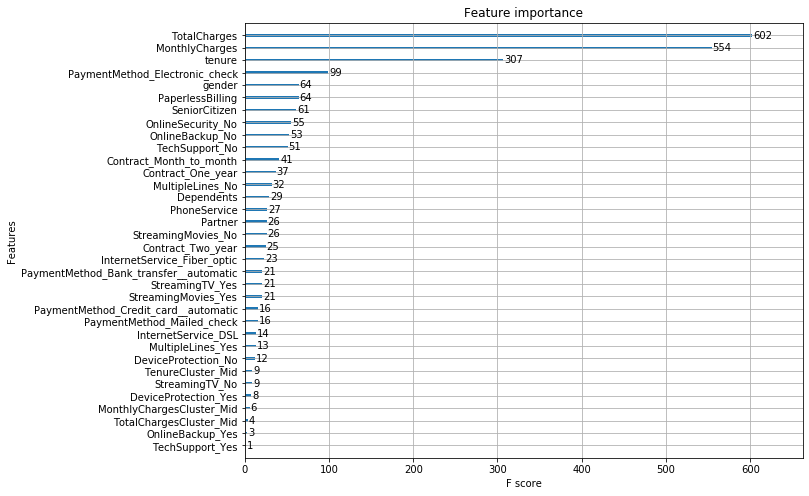

In [114]:
from xgboost import plot_importance
fig, ax = plt.subplots(figsize=(10, 8))
plot_importance(xgb_model, ax=ax)

In [115]:
x = [1, 1, 2, 4, 5, 9, 10, 13, 14, 15, 17, 18, 18, 18, 18, 18, 19, 22, 30, 32, 37, 40, 42, 44, 46, 52, 53, 58, 75, 83, 109, 313, 540, 579]
y = ['OnlineSecurity_Yes', 'TechSupport_Yes', 'TenureCluster_Mid', 'MonthlyChargesCluster_Mid', 'OnlineBackup_Yes', 'TotalChargesCluster_Mid',
                'MultipleLines_Yes', 'InternetService_DSL', 'StreamingTV_Yes', 'InternetService_Fiber_optic', 'DeviceProtection_No',
                 'StreamingTV_No', 'StreamingMovies_Yes', 'StreamingMovies_No', 'PaymentMethod_Mailed_check', 'PaymentMethod_Bank_transfer_automatic_',
                 'Partner', 'PhoneService', 'Contract_Two_year', 'MultipleLines_No', 'PaymentMethod_Credit_card_automatic_', 'Dependents',
                 'Contract_Month_to_month', 'Contract_One_Year', 'TechSupport_No', 'PaperlessBilling', 'OnlineBackup_No', 'OnlineSecurity_No',
                 'SeniorCitizen', 'gender', 'PaymentMethod_Electronic_check', 'tenure', 'MonthlyCharges','TotalCharges']
color = ['slategray', 'purple', 'green', 'slategray', 'purple', 'green', 'slategray', 'purple', 'green', 'slategray', 'purple', 'green',
                  'slategray', 'purple', 'green', 'slategray', 'purple', 'green', 'slategray', 'purple', 'green', 'slategray', 'purple', 'green', 'slategray', 'purple', 'green', 
                  'slategray', 'purple', 'green','slategray', 'purple', 'green', 'slategray']
# Plot Feature Importance for Plotly.
plot_data_featureImportance = [
    go.Bar(
        x=x,
        y=y,
        name='Feature Importance',
        hovertemplate =
    '<b>Feature</b>: %{y}'+
    '<br><b>F Score</b>: %{x}<br>',
        marker= dict(
            color=color
        ),
        orientation='h'
    )
]

plot_layout_featureImportance = go.Layout(
        yaxis={"type": "category"},
        title='Feature Importance',
        margin=dict(l=250, r=50, t=50, b=50),
        plot_bgcolor  = "rgb(243,243,243)",
        paper_bgcolor  = "rgb(243,243,243)"
)

fig_featureImportance = go.Figure(data=plot_data_featureImportance, layout=plot_layout_featureImportance)
fig_featureImportance.update_xaxes(title_text='F-Score')
fig_featureImportance.update_yaxes(title_text='Feature', tickfont=dict(size=9), )
pyoff.iplot(fig_featureImportance)

We can see that our model assigned more importance to TotalCharges and MonthlyCharges compared to others.

Finally, the best way to use this model is assigning Churn Probability for each customer, create segments, and build strategies on top of that.

In [116]:
telco_df['proba'] = xgb_model.predict_proba(telco_df[X_train.columns])[:,1]

In [117]:
telco_df[['customerID', 'proba']].head(10)

,customerID,proba
0,7590-VHVEG,0.613398
1,6713-OKOMC,0.162565
2,7469-LKBCI,0.019136
3,8779-QRDMV,0.918786
4,1680-VDCWW,0.040398
5,1066-JKSGK,0.402158
6,8665-UTDHZ,0.681290
7,7310-EGVHZ,0.432888
8,9867-JCZSP,0.024049
9,0278-YXOOG,0.141113


Now that we know which customers are most likely to churn, we can go ahead and build actions based on our results.

In [118]:
import shap

shap.initjs()

explainer = shap.TreeExplainer(xgb_model)
shap_values = explainer.shap_values(X)

In [119]:
shap.force_plot(explainer.expected_value, shap_values[0,:], X.iloc[0,:])

In [120]:
shap.force_plot(explainer.expected_value, shap_values, X)

C:\ProgramData\Anaconda3\lib\site-packages\shap\plots\force.py:145: UserWarning:

shap.force_plot is slow for many thousands of rows, try subsampling your data.



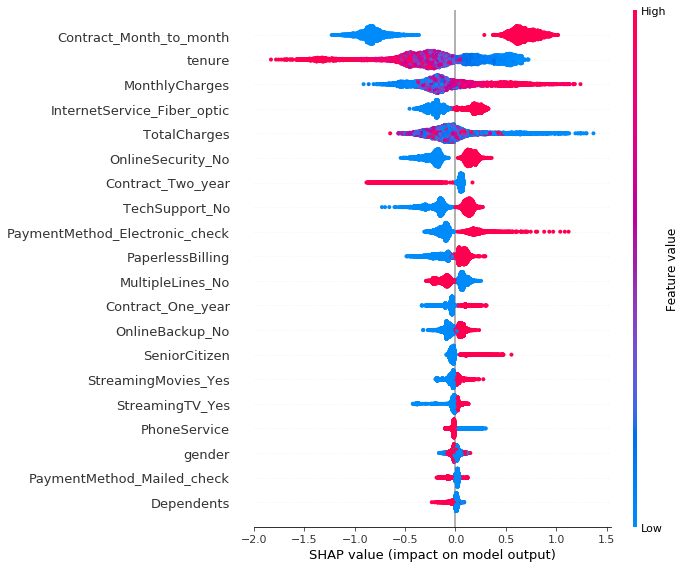

In [121]:
shap.summary_plot(shap_values, X)

In [122]:
# Create probability df and merge with final df. 
prob_telco_df = telco_df[['customerID', 'proba']]

In [123]:
# Merge both DFs back together.
final_telco_df = final_telco_df.merge(prob_telco_df, on='customerID')

In [124]:
# Convert Churn & SeniorCitizen binary integers back to Yes/No.
# final_telco_df.loc[final_telco_df.Churn=='No', 'Churn'] = 0
# final_telco_df.loc[final_telco_df.Churn=='Yes', 'Churn'] = 1
final_telco_df.loc[final_telco_df.SeniorCitizen==0, 'SeniorCitizen'] = 'No'
final_telco_df.loc[final_telco_df.SeniorCitizen==1, 'SeniorCitizen'] = 'Yes'
final_telco_df.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,TenureCluster,MonthlyChargesCluster,TotalChargesCluster,proba
0,7590-VHVEG,Female,No,Yes,No,1,No,No phone service,DSL,No,...,Month-to-month,Yes,Electronic check,29.85,29.85,0,Low,Low,Low,0.613398
1,6713-OKOMC,Female,No,No,No,10,No,No phone service,DSL,Yes,...,Month-to-month,No,Mailed check,29.75,301.90,0,Low,Low,Low,0.162565
2,7469-LKBCI,Male,No,No,No,16,Yes,No,No,No internet service,...,Two year,No,Credit card (automatic),18.95,326.80,0,Low,Low,Low,0.019136
3,8779-QRDMV,Male,Yes,No,No,1,No,No phone service,DSL,No,...,Month-to-month,Yes,Electronic check,39.65,39.65,1,Low,Low,Low,0.918786
4,1680-VDCWW,Male,No,Yes,No,12,Yes,No,No,No internet service,...,One year,No,Bank transfer (automatic),19.80,202.25,0,Low,Low,Low,0.040398


In [125]:
final_telco_df.columns

Index(['customerID', 'gender', 'SeniorCitizen', 'Partner', 'Dependents',
       'tenure', 'PhoneService', 'MultipleLines', 'InternetService',
       'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport',
       'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling',
       'PaymentMethod', 'MonthlyCharges', 'TotalCharges', 'Churn',
       'TenureCluster', 'MonthlyChargesCluster', 'TotalChargesCluster',
       'proba'],
      dtype='object')

In [126]:
future_retention_df = final_telco_df[final_telco_df.Churn == 0]
future_retention_df

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,TenureCluster,MonthlyChargesCluster,TotalChargesCluster,proba
0,7590-VHVEG,Female,No,Yes,No,1,No,No phone service,DSL,No,...,Month-to-month,Yes,Electronic check,29.85,29.85,0,Low,Low,Low,0.613398
1,6713-OKOMC,Female,No,No,No,10,No,No phone service,DSL,Yes,...,Month-to-month,No,Mailed check,29.75,301.90,0,Low,Low,Low,0.162565
2,7469-LKBCI,Male,No,No,No,16,Yes,No,No,No internet service,...,Two year,No,Credit card (automatic),18.95,326.80,0,Low,Low,Low,0.019136
4,1680-VDCWW,Male,No,Yes,No,12,Yes,No,No,No internet service,...,One year,No,Bank transfer (automatic),19.80,202.25,0,Low,Low,Low,0.040398
7,7310-EGVHZ,Male,No,No,No,1,Yes,No,No,No internet service,...,Month-to-month,No,Bank transfer (automatic),20.20,20.20,0,Low,Low,Low,0.432888
8,9867-JCZSP,Female,No,Yes,Yes,17,Yes,No,No,No internet service,...,One year,No,Mailed check,20.75,418.25,0,Low,Low,Low,0.024049
10,6380-ARCEH,Male,No,No,No,1,Yes,No,No,No internet service,...,Month-to-month,No,Mailed check,20.20,20.20,0,Low,Low,Low,0.364261
11,3679-XASPY,Female,No,Yes,Yes,1,Yes,No,No,No internet service,...,Month-to-month,No,Electronic check,19.45,19.45,0,Low,Low,Low,0.217612
12,6180-YBIQI,Male,No,No,No,5,No,No phone service,DSL,No,...,Month-to-month,No,Mailed check,24.30,100.20,0,Low,Low,Low,0.365266
13,2928-HLDBA,Female,No,No,No,6,Yes,No,No,No internet service,...,Month-to-month,No,Mailed check,20.70,112.75,0,Low,Low,Low,0.115673


In [127]:
# Apply KMeans to predict Probability Clusters.
kmeans = KMeans(n_clusters=4)
kmeans.fit(future_retention_df[['proba']])
future_retention_df['ProbabilityCluster'] = kmeans.predict(future_retention_df[['proba']])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [128]:
# Apply order_cluster function to Probability Cluster.
future_retention_df = order_cluster('ProbabilityCluster', 'proba', future_retention_df, True)

In [129]:
future_retention_df.groupby('ProbabilityCluster').proba.describe()

,count,mean,std,min,25%,50%,75%,max
ProbabilityCluster,,,,,,,,
0,2653.0,0.033226,0.027118,0.001946,0.012008,0.022475,0.051582,0.100264
1,1284.0,0.167337,0.045759,0.100768,0.127640,0.159935,0.203240,0.260318
2,789.0,0.353599,0.063513,0.260629,0.297933,0.341317,0.407799,0.481763
3,437.0,0.610600,0.092501,0.482604,0.533303,0.597982,0.662795,0.869736


In [130]:
# Apply Low, Mid, High labels to each Probability Cluster.
future_retention_df['ProbabilityCluster'] = future_retention_df['ProbabilityCluster'].replace({0: 'Low', 1: 'Mid-Low', 2: 'Mid-High', 3: 'High'})

In [131]:
future_retention_df

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,TenureCluster,MonthlyChargesCluster,TotalChargesCluster,proba,ProbabilityCluster
0,7590-VHVEG,Female,No,Yes,No,1,No,No phone service,DSL,No,...,Yes,Electronic check,29.85,29.85,0,Low,Low,Low,0.613398,High
1,4195-NZGTA,Female,No,No,No,1,No,No phone service,DSL,No,...,No,Electronic check,25.25,25.25,0,Low,Low,Low,0.521865,High
2,3050-GBUSH,Female,No,No,No,3,No,No phone service,DSL,No,...,Yes,Credit card (automatic),34.80,113.95,0,Low,Low,Low,0.630636,High
3,3748-FVMZZ,Male,No,No,No,4,No,No phone service,DSL,No,...,Yes,Electronic check,40.05,162.45,0,Low,Low,Low,0.532144,High
4,7537-RBWEA,Female,No,No,No,1,No,No phone service,DSL,No,...,Yes,Mailed check,25.15,25.15,0,Low,Low,Low,0.565934,High
5,6637-KYRCV,Female,No,Yes,Yes,5,No,No phone service,DSL,No,...,Yes,Electronic check,30.50,167.20,0,Low,Low,Low,0.544142,High
6,7389-KBFIT,Female,No,Yes,Yes,2,No,No phone service,DSL,No,...,Yes,Mailed check,30.25,63.75,0,Low,Low,Low,0.612284,High
7,4236-UJPWO,Female,No,No,No,2,No,No phone service,DSL,No,...,No,Electronic check,24.50,46.40,0,Low,Low,Low,0.526496,High
8,9743-DQKQW,Male,No,No,No,3,No,No phone service,DSL,No,...,No,Electronic check,25.10,79.80,0,Low,Low,Low,0.575299,High
9,0928-JMXNP,Male,Yes,Yes,No,4,No,No phone service,DSL,No,...,Yes,Electronic check,29.90,118.25,0,Low,Low,Low,0.577366,High


In [132]:
final_telco_df.to_csv("data/final_telco_df.csv", index=False)
fileName='data/final_telco_df.csv'
upload_file(fileName, bucketName)

True

In [133]:
future_retention_df.to_csv("data/future_retention_df.csv", index=False)
fileName='data/future_retention_df.csv'
upload_file(fileName, bucketName)

True

In [134]:
rowEvenColor = 'green'
rowOddColor = 'purple'
figProba = go.Figure(data=[go.Table(
#     columnwidth = [1000,400],
    header=dict(values=final_telco_df.columns,
                fill_color='slategray',
                align='left',
                font=dict(color='white', size=12)),
    cells=dict(values=[final_telco_df.customerID, final_telco_df.gender, final_telco_df.SeniorCitizen, final_telco_df.Partner,
                       final_telco_df.Dependents, final_telco_df.tenure, final_telco_df.PhoneService, final_telco_df.MultipleLines,
                       final_telco_df.InternetService, final_telco_df.OnlineSecurity, final_telco_df.OnlineBackup, final_telco_df.DeviceProtection,
                       final_telco_df.TechSupport, final_telco_df.StreamingTV, final_telco_df.StreamingMovies, final_telco_df.Contract,
                       final_telco_df.PaperlessBilling, final_telco_df.PaymentMethod, final_telco_df.MonthlyCharges, final_telco_df.TotalCharges,
                       final_telco_df.Churn, final_telco_df.TenureCluster, final_telco_df.MonthlyChargesCluster, final_telco_df.TotalChargesCluster,
                       (final_telco_df.proba)*100],
               fill_color = [[rowOddColor,rowEvenColor,rowOddColor, rowEvenColor]*1758],
               align='left',
               font= dict(color='white', size=12)))
])

pyoff.iplot(figProba)

In [135]:
future_retention_df.groupby('ProbabilityCluster').count().reset_index()

,ProbabilityCluster,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,...,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,TenureCluster,MonthlyChargesCluster,TotalChargesCluster,proba
0,High,437,437,437,437,437,437,437,437,437,...,437,437,437,437,437,437,437,437,437,437
1,Low,2653,2653,2653,2653,2653,2653,2653,2653,2653,...,2653,2653,2653,2653,2653,2653,2653,2653,2653,2653
2,Mid-High,789,789,789,789,789,789,789,789,789,...,789,789,789,789,789,789,789,789,789,789
3,Mid-Low,1284,1284,1284,1284,1284,1284,1284,1284,1284,...,1284,1284,1284,1284,1284,1284,1284,1284,1284,1284
